# Analytics

Analyzing the data gathered from the logs will be done here; reading each file line-by-line to add them into a dictionary that could then be converted into a dataframe table which allows exports to CSV or even an Excel file.

## Imports

All needed libraries will be imported here.

Unless conditional, all imports must be done in this section to prevent workspace cluttering. Imports are sorted in an ascending manner, starting from "a" to "Z".

In [1]:
from typing import Tuple, Union
import json
import math
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import seaborn as sns

## Data and Variables

Sets all the global data and variables here.

Global variables will be defined and instantiated in this section, preventing a confusing clutter down the line and allowing readability when revisions are needed.

In [2]:
logs: Union[pd.DataFrame, dict] = {}
"""
Holds the logged data lines from the log files as a
pandas `DataFrame`.
"""

output_root_dir: str = "./../out/"
"""
The root directory where the output files are stored.
This will be the directory where all the `.log` files
are stored.
"""

related_cols: dict = {
    'cpu': ['cpu_percent_peak', 'cpu_percent', 'cpu_power'],
    'gpu': ['gpu_load', 'gpu_load_peak', 'gpu_power', 'gpu_power_peak', 'gpu_temp', 'gpu_temp_peak'],
}

None

In [3]:
def load_logs(dir: str) -> dict:
    """
    Loads the log files from the specified directory.

    :param dir: The directory to load the log files from.
    :type dir: str

    :return: A dictionary containing the logged data.
    :rtype: dict

    :raises FileNotFoundError: If the specified directory does not exist.
    """
    logs: list = []

    if not os.path.exists(dir):
        raise FileNotFoundError(f"Directory '{dir}' does not exist.")
    
    for root, dirs, files in os.walk(dir):
        for file in files:
            if file.endswith(".log"):
                location = os.path.join(root, file)
                with open(location, 'r') as f:
                    for line in f:
                        try:
                            data = json.loads(line.strip())
                            logs.append(data)
                        except json.JSONDecodeError:
                            print(f"Skipping invalid JSON line in {file}: {line.strip()}")

    return logs

def create_subplots(*cols: str) -> tuple:
    """
    Creates a single matplotlib figure with subplots organized in a grid.

    :param cols: An arbitrary number of positional arguments (e.g., column names). The number of arguments determines the number of subplots created.
    :type cols: str

    :returns: A tuple containing the figure and axes objects.
    :rtype: Tuple[plt.Figure, np.ndarray]

    :raises ValueError: If no columns are provided.
    """
    num_plots: int = len(cols)

    if num_plots == 0:
        print("Warning: No columns provided. Returning None for figure and axes.")
        return None, None

    # Sets the row and column lengths based on the number of plots.
    # 3 columns at max.
    rows: int = 0
    cols: int = 0
    if num_plots == 1:
        rows, cols = 1, 1
    elif num_plots == 2:
        rows, cols = 1, 2
    elif num_plots == 3:
        rows, cols = 1, 3
    else:
        cols = 3
        rows = math.ceil(num_plots / cols)

    # Set the size of the figure based on the number of rows and columns.
    # Measurement units are in inches. [cols == width, rows == height]
    figsize: tuple = (
        cols * 6,
        rows * 5,
    )

    fig, axes = plt.subplots(
        nrows = rows,
        ncols = cols,
        figsize = figsize,
        dpi = 300,
    )

    # Flatten axes for easy iteration
    # If there's only one subplot, axes will be a single Axes object.
    if num_plots == 1:
        axes_flat = np.array([axes])
    else:
        axes_flat = axes.flatten()

    # Delete unused plots
    for i in range(num_plots, len(axes_flat)):
        fig.delaxes(axes_flat[i])

    # Adjust layout to prevent titles/labels from overlapping
    plt.tight_layout(
        pad = 3,
        h_pad = 5,
    )

    return fig, axes_flat

None

In [4]:
for dirs in os.scandir(output_root_dir):
    if dirs.is_dir():
        dir_name = dirs.name
        dir = os.path.join(output_root_dir, dir_name)
        logs[dir_name] = pd.DataFrame(load_logs(dir))

In [5]:
logs["cpu"]

,epoch,loss,accuracy,val_loss,val_accuracy,training_time_hours,platform,lr_strategy,env_temp,cpu_percent_peak,...,gpu_power_peak,gpu_temp,gpu_temp_peak,cost_efficiency_local,cost_per_accuracy_point_local,cost_efficiency_usd,cost_per_accuracy_point_usd,power_efficiency,time_efficiency,timestamp
0,1,2.219906,0.27325,3.007077,0.132812,0.297923,Intel i5-11400H,EarlyStopping & ReduceLROnPlateau,31.0,100.0,...,N/A,N/A,N/A,353.341065,0.002830,6.360139,0.157229,1.290589,91.718454,2025-06-09 10:29:13
1,2,1.792391,0.37355,1.331330,0.516827,0.580274,Intel i5-11400H,EarlyStopping & ReduceLROnPlateau,31.1,64.4,...,N/A,N/A,N/A,371.015216,0.002695,6.678274,0.149739,2.639463,64.374720,2025-06-09 10:46:09
2,3,1.609451,0.42605,1.603642,0.467147,0.864418,Intel i5-11400H,EarlyStopping & ReduceLROnPlateau,31.3,65.1,...,N/A,N/A,N/A,283.071935,0.003533,5.095295,0.196259,2.999930,49.287500,2025-06-09 11:03:12
3,4,1.461982,0.47795,1.301916,0.535256,1.149874,Intel i5-11400H,EarlyStopping & ReduceLROnPlateau,31.2,65.2,...,N/A,N/A,N/A,236.994647,0.004220,4.265904,0.234417,3.341023,41.565408,2025-06-09 11:20:20
4,5,1.362315,0.52045,1.268112,0.570513,1.438982,Intel i5-11400H,EarlyStopping & ReduceLROnPlateau,31.1,78.2,...,N/A,N/A,N/A,197.878733,0.005054,3.561817,0.280756,3.490962,36.167921,2025-06-09 11:37:41
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
318,96,0.209992,0.92730,0.410206,0.877404,25.304024,Intel i5-11400H,,27.4,95.3,...,N/A,N/A,N/A,15.725475,0.063591,0.283059,3.532838,4.878472,3.664634,2025-06-07 01:28:21
319,97,0.210322,0.92695,0.336745,0.896835,25.590487,Intel i5-11400H,,27.4,98.2,...,N/A,N/A,N/A,16.592381,0.060269,0.298663,3.348257,5.205683,3.622244,2025-06-07 01:45:32
320,98,0.214000,0.92510,0.364245,0.885417,25.889162,Intel i5-11400H,,27.2,99.6,...,N/A,N/A,N/A,16.331084,0.061233,0.293960,3.401829,5.183504,3.573310,2025-06-07 02:03:27
321,99,0.210748,0.92720,0.499572,0.859976,26.182066,Intel i5-11400H,,27.2,95.9,...,N/A,N/A,N/A,15.135552,0.066070,0.272440,3.670534,4.858393,3.541355,2025-06-07 02:21:02


In [6]:
logs["gpu"]

,epoch,loss,accuracy,val_loss,val_accuracy,training_time_hours,platform,lr_strategy,env_temp,cpu_percent_peak,...,gpu_power_peak,gpu_temp,gpu_temp_peak,cost_efficiency_local,cost_per_accuracy_point_local,cost_efficiency_usd,cost_per_accuracy_point_usd,power_efficiency,time_efficiency,timestamp
0,1,2.232344,0.27535,2.858362,0.157051,0.012374,RTX 3050 Ti Laptop,EarlyStopping & ReduceLROnPlateau,32.3,48.8,...,72.69,82.04,87.0,3772.179662,0.000265,67.899234,0.014728,0.572251,2225.263178,2025-06-05 21:36:01
1,2,1.785209,0.37130,1.507845,0.458333,0.029377,RTX 3050 Ti Laptop,EarlyStopping & ReduceLROnPlateau,32.3,48.8,...,72.69,82.40,87.0,2163.152309,0.000462,38.936742,0.025683,0.779085,1263.915206,2025-06-05 21:37:02
2,3,1.603553,0.43045,1.592051,0.484575,0.046340,RTX 3050 Ti Laptop,EarlyStopping & ReduceLROnPlateau,32.3,48.8,...,72.69,82.60,87.0,1601.278497,0.000625,28.823013,0.034694,0.909735,928.892305,2025-06-05 21:38:03
3,4,1.458386,0.47760,1.213379,0.562700,0.063326,RTX 3050 Ti Laptop,EarlyStopping & ReduceLROnPlateau,32.3,48.8,...,72.69,82.68,87.0,1301.407404,0.000768,23.425333,0.042689,1.010377,754.196915,2025-06-05 21:39:04
4,5,1.366265,0.51465,1.319028,0.555889,0.080336,RTX 3050 Ti Laptop,EarlyStopping & ReduceLROnPlateau,32.3,48.8,...,72.69,82.73,87.0,1109.269982,0.000901,19.966860,0.050083,1.092536,640.625112,2025-06-05 21:40:05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1786,96,0.211866,0.92835,0.336436,0.898638,1.209660,RTX 3050 Ti Laptop,,28.2,38.6,...,68.61,85.87,88.0,124.084746,0.008059,2.233525,0.447723,1.840230,76.744721,2025-06-11 09:40:44
1787,97,0.215829,0.92530,0.334519,0.891827,1.222352,RTX 3050 Ti Laptop,,28.2,38.6,...,56.29,85.98,88.0,121.704146,0.008217,2.190675,0.456480,1.823862,75.698346,2025-06-11 09:41:30
1788,98,0.212751,0.92545,0.319927,0.895633,1.235213,RTX 3050 Ti Laptop,,28.2,38.6,...,54.11,85.98,88.0,120.866265,0.008274,2.175593,0.459645,1.830363,74.922322,2025-06-11 09:42:16
1789,99,0.215444,0.92445,0.319960,0.901242,1.248030,RTX 3050 Ti Laptop,,28.2,38.6,...,54.11,85.98,88.0,119.544126,0.008365,2.151794,0.464728,1.829127,74.072712,2025-06-11 09:43:02


## (Pre-)Processing

Processes the logs without changing the original source for reuse in case of a f***ed up occurence.

In here, the data will be cleaned and given a structured format, addressing inconsistencies, missing values, and preparing it for subsequent analysis. This section ensures the reliability and integrity of the dataset derived from the raw logs.

**Key Steps for Data Cleaning:**

- [**Handling Missing Values:**](#missing-values) Identify and decide how to treat missing entries (e.g., imputation, removal).
- [**Data Type Conversion:**](#data-type-conversion) Ensure columns have the correct data types (e.g., numeric for calculations, datetime for time series analysis).
- [**Outlier Detection and Treatment:**](#outlier-detection-and-treatment) Identify and decide how to manage anomalous data points.
- **Data Consistency and Standardization:** Address variations in data entry, units, or formats. (This is done with the Outlier Detection section)
- **Feature Engineering (Basic):** Create new features from existing ones that might be more useful for analysis. (This is done with the Outlier Detection section)

In [7]:
logs["cpu"].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 323 entries, 0 to 322
Data columns (total 25 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   epoch                          323 non-null    int64  
 1   loss                           323 non-null    float64
 2   accuracy                       323 non-null    float64
 3   val_loss                       323 non-null    float64
 4   val_accuracy                   323 non-null    float64
 5   training_time_hours            323 non-null    float64
 6   platform                       323 non-null    object 
 7   lr_strategy                    323 non-null    object 
 8   env_temp                       323 non-null    float64
 9   cpu_percent_peak               323 non-null    float64
 10  cpu_percent                    323 non-null    float64
 11  cpu_power                      323 non-null    float64
 12  gpu_load                       323 non-null    obj

In [8]:
logs["gpu"].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1791 entries, 0 to 1790
Data columns (total 25 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   epoch                          1791 non-null   int64  
 1   loss                           1791 non-null   float64
 2   accuracy                       1791 non-null   float64
 3   val_loss                       1791 non-null   float64
 4   val_accuracy                   1791 non-null   float64
 5   training_time_hours            1791 non-null   float64
 6   platform                       1791 non-null   object 
 7   lr_strategy                    1791 non-null   object 
 8   env_temp                       1791 non-null   float64
 9   cpu_percent_peak               1791 non-null   float64
 10  cpu_percent                    1791 non-null   float64
 11  cpu_power                      1791 non-null   float64
 12  gpu_load                       1791 non-null   f

### Missing Values

`"N/A"` will be replaced with `0` if the type is numeric, or `"None"` if it's not.

In [9]:
empty_cols = {
    'cpu': {
        'na': [],
        'empty': []
    },
    'gpu': {
        'na': [],
        'empty': []
    },
}

In [10]:
print(f"{'-'*5} CPU Logs (\"N/A\") {'-'*5}")
for col in logs["cpu"].columns:
    amt = logs["cpu"][col].value_counts().get("N/A", 0)

    if amt > 0:
        empty_cols['cpu']['na'].append(col)
        print(f'[{col}]: {amt}')

print(f"\n\n{'-'*5} CPU Logs (\"\") {'-'*5}")
for col in logs["cpu"].columns:
    amt = logs["cpu"][col].value_counts().get("", 0)

    if amt > 0:
        empty_cols['cpu']['empty'].append(col)
        print(f'[{col}]: {amt}')

----- CPU Logs ("N/A") -----
[gpu_load]: 323
[gpu_load_peak]: 323
[gpu_power]: 323
[gpu_power_peak]: 323
[gpu_temp]: 323
[gpu_temp_peak]: 323


----- CPU Logs ("") -----
[lr_strategy]: 100


In [11]:
print(f"{'-'*5} GPU Logs (\"N/A\") {'-'*5}")
for col in logs["gpu"].columns:
    amt = logs["gpu"][col].value_counts().get("N/A", 0)

    if amt > 0:
        empty_cols['gpu']['na'].append(col)
        print(f'[{col}]: {amt}')

print(f"\n\n{'-'*5} GPU Logs (\"\") {'-'*5}")
for col in logs["gpu"].columns:
    amt = logs["gpu"][col].value_counts().get("", 0)

    if amt > 0:
        empty_cols['gpu']['empty'].append(col)
        print(f'[{col}]: {amt}')

----- GPU Logs ("N/A") -----


----- GPU Logs ("") -----
[lr_strategy]: 500


In [12]:
for platform, obj in empty_cols.items():
    print(f"\n\n{'-'*5} {platform.upper()} Logs {'-'*5}")
    print(f"Columns with 'N/A': {obj['na']}")
    print(f"Columns with '': {obj['empty']}\n")

    for val, cols in obj.items():
        params = []

        if len(cols) > 0:
            if val == 'na':
                params.append("N/A")
                params.append(0)
            elif val == 'empty':
                params.append("")
                params.append("None")

            for col in cols:
                logs[platform][col] = logs[platform][col].replace(*params)
                print(f"Replaced '{val}' in column '{col}' of '{platform}' with {params[1]}.")



----- CPU Logs -----
Columns with 'N/A': ['gpu_load', 'gpu_load_peak', 'gpu_power', 'gpu_power_peak', 'gpu_temp', 'gpu_temp_peak']
Columns with '': ['lr_strategy']

Replaced 'na' in column 'gpu_load' of 'cpu' with 0.
Replaced 'na' in column 'gpu_load_peak' of 'cpu' with 0.
Replaced 'na' in column 'gpu_power' of 'cpu' with 0.
Replaced 'na' in column 'gpu_power_peak' of 'cpu' with 0.
Replaced 'na' in column 'gpu_temp' of 'cpu' with 0.
Replaced 'na' in column 'gpu_temp_peak' of 'cpu' with 0.
Replaced 'empty' in column 'lr_strategy' of 'cpu' with None.


----- GPU Logs -----
Columns with 'N/A': []
Columns with '': ['lr_strategy']

Replaced 'empty' in column 'lr_strategy' of 'gpu' with None.


C:\Users\Virus5600\AppData\Local\Temp\ipykernel_7400\3552664333.py:18: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  logs[platform][col] = logs[platform][col].replace(*params)


In [13]:
logs["cpu"]

,epoch,loss,accuracy,val_loss,val_accuracy,training_time_hours,platform,lr_strategy,env_temp,cpu_percent_peak,...,gpu_power_peak,gpu_temp,gpu_temp_peak,cost_efficiency_local,cost_per_accuracy_point_local,cost_efficiency_usd,cost_per_accuracy_point_usd,power_efficiency,time_efficiency,timestamp
0,1,2.219906,0.27325,3.007077,0.132812,0.297923,Intel i5-11400H,EarlyStopping & ReduceLROnPlateau,31.0,100.0,...,0,0,0,353.341065,0.002830,6.360139,0.157229,1.290589,91.718454,2025-06-09 10:29:13
1,2,1.792391,0.37355,1.331330,0.516827,0.580274,Intel i5-11400H,EarlyStopping & ReduceLROnPlateau,31.1,64.4,...,0,0,0,371.015216,0.002695,6.678274,0.149739,2.639463,64.374720,2025-06-09 10:46:09
2,3,1.609451,0.42605,1.603642,0.467147,0.864418,Intel i5-11400H,EarlyStopping & ReduceLROnPlateau,31.3,65.1,...,0,0,0,283.071935,0.003533,5.095295,0.196259,2.999930,49.287500,2025-06-09 11:03:12
3,4,1.461982,0.47795,1.301916,0.535256,1.149874,Intel i5-11400H,EarlyStopping & ReduceLROnPlateau,31.2,65.2,...,0,0,0,236.994647,0.004220,4.265904,0.234417,3.341023,41.565408,2025-06-09 11:20:20
4,5,1.362315,0.52045,1.268112,0.570513,1.438982,Intel i5-11400H,EarlyStopping & ReduceLROnPlateau,31.1,78.2,...,0,0,0,197.878733,0.005054,3.561817,0.280756,3.490962,36.167921,2025-06-09 11:37:41
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
318,96,0.209992,0.92730,0.410206,0.877404,25.304024,Intel i5-11400H,None,27.4,95.3,...,0,0,0,15.725475,0.063591,0.283059,3.532838,4.878472,3.664634,2025-06-07 01:28:21
319,97,0.210322,0.92695,0.336745,0.896835,25.590487,Intel i5-11400H,None,27.4,98.2,...,0,0,0,16.592381,0.060269,0.298663,3.348257,5.205683,3.622244,2025-06-07 01:45:32
320,98,0.214000,0.92510,0.364245,0.885417,25.889162,Intel i5-11400H,None,27.2,99.6,...,0,0,0,16.331084,0.061233,0.293960,3.401829,5.183504,3.573310,2025-06-07 02:03:27
321,99,0.210748,0.92720,0.499572,0.859976,26.182066,Intel i5-11400H,None,27.2,95.9,...,0,0,0,15.135552,0.066070,0.272440,3.670534,4.858393,3.541355,2025-06-07 02:21:02


In [14]:
logs["gpu"]

,epoch,loss,accuracy,val_loss,val_accuracy,training_time_hours,platform,lr_strategy,env_temp,cpu_percent_peak,...,gpu_power_peak,gpu_temp,gpu_temp_peak,cost_efficiency_local,cost_per_accuracy_point_local,cost_efficiency_usd,cost_per_accuracy_point_usd,power_efficiency,time_efficiency,timestamp
0,1,2.232344,0.27535,2.858362,0.157051,0.012374,RTX 3050 Ti Laptop,EarlyStopping & ReduceLROnPlateau,32.3,48.8,...,72.69,82.04,87.0,3772.179662,0.000265,67.899234,0.014728,0.572251,2225.263178,2025-06-05 21:36:01
1,2,1.785209,0.37130,1.507845,0.458333,0.029377,RTX 3050 Ti Laptop,EarlyStopping & ReduceLROnPlateau,32.3,48.8,...,72.69,82.40,87.0,2163.152309,0.000462,38.936742,0.025683,0.779085,1263.915206,2025-06-05 21:37:02
2,3,1.603553,0.43045,1.592051,0.484575,0.046340,RTX 3050 Ti Laptop,EarlyStopping & ReduceLROnPlateau,32.3,48.8,...,72.69,82.60,87.0,1601.278497,0.000625,28.823013,0.034694,0.909735,928.892305,2025-06-05 21:38:03
3,4,1.458386,0.47760,1.213379,0.562700,0.063326,RTX 3050 Ti Laptop,EarlyStopping & ReduceLROnPlateau,32.3,48.8,...,72.69,82.68,87.0,1301.407404,0.000768,23.425333,0.042689,1.010377,754.196915,2025-06-05 21:39:04
4,5,1.366265,0.51465,1.319028,0.555889,0.080336,RTX 3050 Ti Laptop,EarlyStopping & ReduceLROnPlateau,32.3,48.8,...,72.69,82.73,87.0,1109.269982,0.000901,19.966860,0.050083,1.092536,640.625112,2025-06-05 21:40:05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1786,96,0.211866,0.92835,0.336436,0.898638,1.209660,RTX 3050 Ti Laptop,None,28.2,38.6,...,68.61,85.87,88.0,124.084746,0.008059,2.233525,0.447723,1.840230,76.744721,2025-06-11 09:40:44
1787,97,0.215829,0.92530,0.334519,0.891827,1.222352,RTX 3050 Ti Laptop,None,28.2,38.6,...,56.29,85.98,88.0,121.704146,0.008217,2.190675,0.456480,1.823862,75.698346,2025-06-11 09:41:30
1788,98,0.212751,0.92545,0.319927,0.895633,1.235213,RTX 3050 Ti Laptop,None,28.2,38.6,...,54.11,85.98,88.0,120.866265,0.008274,2.175593,0.459645,1.830363,74.922322,2025-06-11 09:42:16
1789,99,0.215444,0.92445,0.319960,0.901242,1.248030,RTX 3050 Ti Laptop,None,28.2,38.6,...,54.11,85.98,88.0,119.544126,0.008365,2.151794,0.464728,1.829127,74.072712,2025-06-11 09:43:02


### Data Type Conversion

Converts the data type of columns that are mixed.

In [15]:
for platform, df in logs.items():
    for target in empty_cols[platform]:
        print(f"{platform.upper()} - {target} columns: {empty_cols[platform][target]}")

CPU - na columns: ['gpu_load', 'gpu_load_peak', 'gpu_power', 'gpu_power_peak', 'gpu_temp', 'gpu_temp_peak']
CPU - empty columns: ['lr_strategy']
GPU - na columns: []
GPU - empty columns: ['lr_strategy']


In [16]:
for platform, df in logs.items():
    for target in empty_cols[platform]:
        for col in empty_cols[platform][target]:
            if col in df.columns:
                converted_to = ''
                if target == 'na':
                    df[col] = pd.to_numeric(df[col], errors='coerce')
                    converted_to = 'numeric'
                elif target == 'empty':
                    df[col] = df[col].astype(str)
                    converted_to = 'string'
                print(f"Converted column '{col}' in '{platform}' logs to {converted_to} type.")
            else:
                print(f"No columns to convert in '{platform}' logs for target '{target}'.")

for platform, df in logs.items():
    if 'timestamp' in df.columns:
        df['timestamp'] = pd.to_datetime(df['timestamp'], errors='coerce')
        print(f"Converted column 'timestamp' in '{platform}' logs to datetime format.")
    else:
        print(f"No 'timestamp' column found in '{platform}' logs.")

Converted column 'gpu_load' in 'cpu' logs to numeric type.
Converted column 'gpu_load_peak' in 'cpu' logs to numeric type.
Converted column 'gpu_power' in 'cpu' logs to numeric type.
Converted column 'gpu_power_peak' in 'cpu' logs to numeric type.
Converted column 'gpu_temp' in 'cpu' logs to numeric type.
Converted column 'gpu_temp_peak' in 'cpu' logs to numeric type.
Converted column 'lr_strategy' in 'cpu' logs to string type.
Converted column 'lr_strategy' in 'gpu' logs to string type.
Converted column 'timestamp' in 'cpu' logs to datetime format.
Converted column 'timestamp' in 'gpu' logs to datetime format.


In [17]:
logs["cpu"].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 323 entries, 0 to 322
Data columns (total 25 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   epoch                          323 non-null    int64         
 1   loss                           323 non-null    float64       
 2   accuracy                       323 non-null    float64       
 3   val_loss                       323 non-null    float64       
 4   val_accuracy                   323 non-null    float64       
 5   training_time_hours            323 non-null    float64       
 6   platform                       323 non-null    object        
 7   lr_strategy                    323 non-null    object        
 8   env_temp                       323 non-null    float64       
 9   cpu_percent_peak               323 non-null    float64       
 10  cpu_percent                    323 non-null    float64       
 11  cpu_power          

In [18]:
logs["gpu"].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1791 entries, 0 to 1790
Data columns (total 25 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   epoch                          1791 non-null   int64         
 1   loss                           1791 non-null   float64       
 2   accuracy                       1791 non-null   float64       
 3   val_loss                       1791 non-null   float64       
 4   val_accuracy                   1791 non-null   float64       
 5   training_time_hours            1791 non-null   float64       
 6   platform                       1791 non-null   object        
 7   lr_strategy                    1791 non-null   object        
 8   env_temp                       1791 non-null   float64       
 9   cpu_percent_peak               1791 non-null   float64       
 10  cpu_percent                    1791 non-null   float64       
 11  cpu_power        

### Outlier Detection and Treatment

Plotting the dataframes and checking for outliers...

#### Strategy-per-Platform Separation

Separate the data per strategy per platform so as to not mess up the plots once we're checking.

In [19]:
# Separate all strategies into their own DataFrame per platform.

cpu_strats = list(logs["cpu"].get("lr_strategy", pd.Series([])).unique())
gpu_strats = list(logs["gpu"].get("lr_strategy", pd.Series([])).unique())

cpu_df = logs["cpu"].copy()
gpu_df = logs["gpu"].copy()

logs = {
    "cpu": {},
    "gpu": {},
}

print(f"""
CPU Strategies:
{cpu_strats}

GPU Strategies:
{gpu_strats}
""".strip())

CPU Strategies:
['EarlyStopping & ReduceLROnPlateau', 'EarlyStopping', 'ReduceLROnPlateau', 'None']

GPU Strategies:
['EarlyStopping & ReduceLROnPlateau', 'EarlyStopping', 'ReduceLROnPlateau', 'None']


##### CPU

Starting with the 4-run CPU data (1 run per strat due to time constraints - see [README's CPU section](./../README.md#cpu)) for more information.

In [20]:
for strat in cpu_strats:
    logs["cpu"][strat] = cpu_df[cpu_df['lr_strategy'] == strat].reset_index(drop=True)

del cpu_df  # Free memory by deleting the original DataFrame
for strat in logs["cpu"]:
    cols = logs["cpu"][strat].columns.tolist()
    print(f"\nCPU Strategy: {strat} (logs['cpu']['{strat}'])")
    print(f"({len(cols)}) {cols}")

logs["cpu"][strat].sort_values(by = ['timestamp', 'epoch', 'lr_strategy'])
for strat, df in logs["cpu"].items():
    logs["cpu"][strat] = []
    
    # Check if current epoch - previous epoch is negative, indicating a new run.
    df['is_new_run'] = (df['epoch'].diff() < 1).fillna(True)
    # Create a cumulative sum of the 'is_new_run' column to assign run IDs.
    df['run_id'] = df['is_new_run'].cumsum()

    for i in range(df['run_id'].nunique()):
        run_df = df[df['run_id'] == i].reset_index(drop = True)
        run_df.drop(columns = ['is_new_run', 'run_id'], inplace = True, errors='ignore')
        run_df.sort_values(by = ['epoch'], inplace = True)
        
        logs["cpu"][strat].append(run_df)


CPU Strategy: EarlyStopping & ReduceLROnPlateau (logs['cpu']['EarlyStopping & ReduceLROnPlateau'])
(25) ['epoch', 'loss', 'accuracy', 'val_loss', 'val_accuracy', 'training_time_hours', 'platform', 'lr_strategy', 'env_temp', 'cpu_percent_peak', 'cpu_percent', 'cpu_power', 'gpu_load', 'gpu_load_peak', 'gpu_power', 'gpu_power_peak', 'gpu_temp', 'gpu_temp_peak', 'cost_efficiency_local', 'cost_per_accuracy_point_local', 'cost_efficiency_usd', 'cost_per_accuracy_point_usd', 'power_efficiency', 'time_efficiency', 'timestamp']

CPU Strategy: EarlyStopping (logs['cpu']['EarlyStopping'])
(25) ['epoch', 'loss', 'accuracy', 'val_loss', 'val_accuracy', 'training_time_hours', 'platform', 'lr_strategy', 'env_temp', 'cpu_percent_peak', 'cpu_percent', 'cpu_power', 'gpu_load', 'gpu_load_peak', 'gpu_power', 'gpu_power_peak', 'gpu_temp', 'gpu_temp_peak', 'cost_efficiency_local', 'cost_per_accuracy_point_local', 'cost_efficiency_usd', 'cost_per_accuracy_point_usd', 'power_efficiency', 'time_efficiency', '

##### GPU

Now with the 20-run GPU data (5 run per strat - see [README's GPU section](./../README.md#gpu)) for more information.

In this section, the GPU will also have to be divided into their respective runs. So the structure would be (in array notation):

```javascript
logs                            // `logs` is the variable name
    ["gpu"]                     // `gpu` is the platform. Can be either `gpu` or `cpu`. In this specific case, we use `gpu` to show the complex structure of GPU logs.
    ["EarlyStopping"]           // `"EarlyStopping"` is a value among the four strategy combinations: `EarlyStopping`, `ReduceLROnPlateau`, `EarlyStopping & ReduceLROnPlateau`, and `None`
    [0]                         // 0 is the index number of the run. It can go up to the total length - 1 of runs done so if there are 5 runs, max index is 4.
    ["epoch"]                   // `epoch` is the column. This could be any column name from the data frame.
```

In [21]:
for strat in gpu_strats:
    logs["gpu"][strat] = gpu_df[gpu_df['lr_strategy'] == strat].reset_index(drop=True)

del gpu_df  # Free memory by deleting the original DataFrame
for strat in logs["gpu"]:
    cols = logs["gpu"][strat].columns.tolist()
    print(f"\nGPU Strategy: {strat} (logs['gpu']['{strat}'])")
    print(f"({len(cols)}) {cols}")

logs["gpu"][strat].sort_values(by = ['timestamp', 'epoch', 'lr_strategy'])
for strat, df in logs["gpu"].items():
    logs["gpu"][strat] = []
    
    # Check if current epoch - previous epoch is negative, indicating a new run.
    df['is_new_run'] = (df['epoch'].diff() < 1).fillna(True)
    # Create a cumulative sum of the 'is_new_run' column to assign run IDs.
    df['run_id'] = df['is_new_run'].cumsum()

    for i in range(df['run_id'].nunique()):
        run_df = df[df['run_id'] == i].reset_index(drop = True)
        run_df.drop(columns = ['is_new_run', 'run_id'], inplace = True, errors='ignore')
        run_df.sort_values(by = ['epoch'], inplace = True)
        
        logs["gpu"][strat].append(run_df)


GPU Strategy: EarlyStopping & ReduceLROnPlateau (logs['gpu']['EarlyStopping & ReduceLROnPlateau'])
(25) ['epoch', 'loss', 'accuracy', 'val_loss', 'val_accuracy', 'training_time_hours', 'platform', 'lr_strategy', 'env_temp', 'cpu_percent_peak', 'cpu_percent', 'cpu_power', 'gpu_load', 'gpu_load_peak', 'gpu_power', 'gpu_power_peak', 'gpu_temp', 'gpu_temp_peak', 'cost_efficiency_local', 'cost_per_accuracy_point_local', 'cost_efficiency_usd', 'cost_per_accuracy_point_usd', 'power_efficiency', 'time_efficiency', 'timestamp']

GPU Strategy: EarlyStopping (logs['gpu']['EarlyStopping'])
(25) ['epoch', 'loss', 'accuracy', 'val_loss', 'val_accuracy', 'training_time_hours', 'platform', 'lr_strategy', 'env_temp', 'cpu_percent_peak', 'cpu_percent', 'cpu_power', 'gpu_load', 'gpu_load_peak', 'gpu_power', 'gpu_power_peak', 'gpu_temp', 'gpu_temp_peak', 'cost_efficiency_local', 'cost_per_accuracy_point_local', 'cost_efficiency_usd', 'cost_per_accuracy_point_usd', 'power_efficiency', 'time_efficiency', '

##### Plotting

Create plots for all the columns to check all data.

In [22]:
not_to_plot: list = [
    "epoch",
    "platform",
    "lr_strategy",
    "timestamp",
]

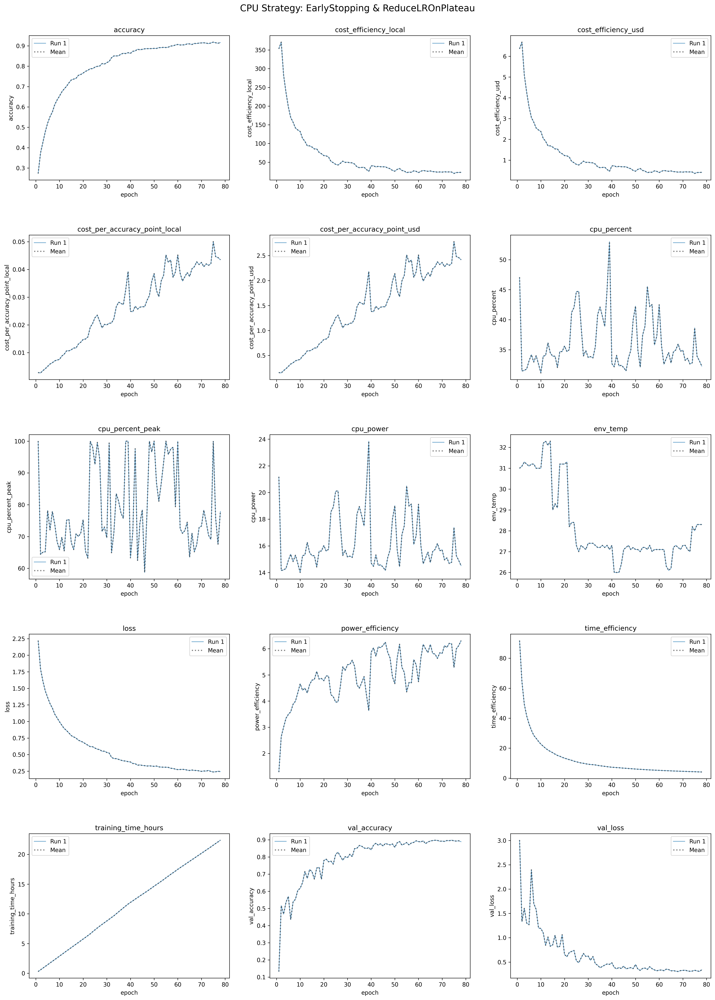

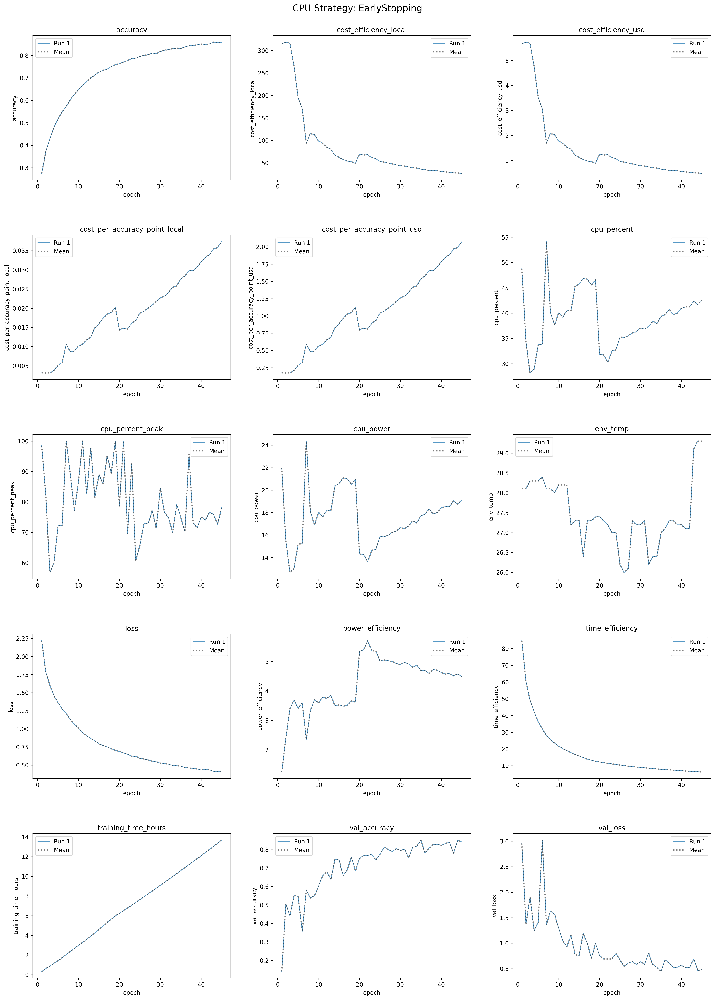

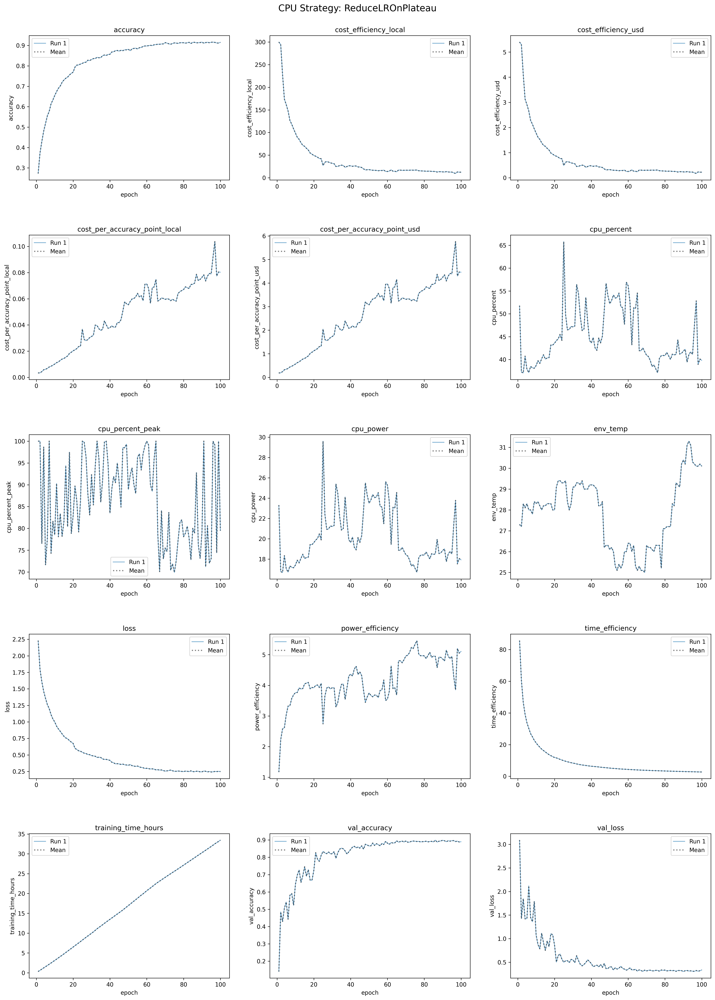

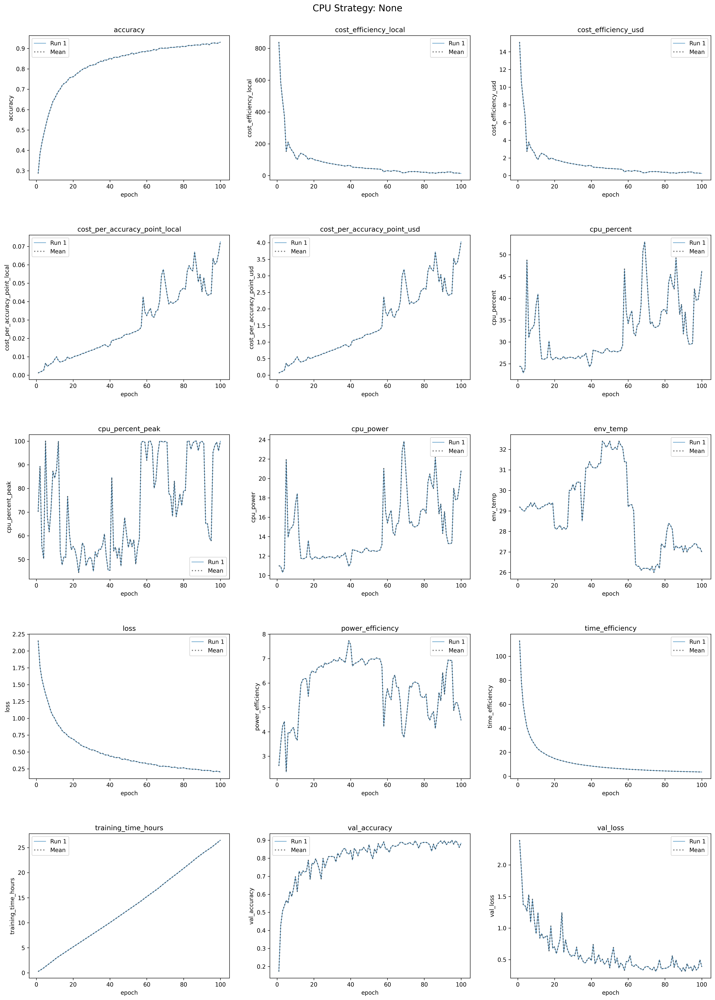

In [25]:
# CPU Plots
for strat in cpu_strats:
    total_runs = len(logs["cpu"][strat])
    evade_cols = [*not_to_plot, *related_cols['gpu']]
    target_cols = list(logs["cpu"][strat][0].columns.difference(evade_cols))
    fig, axes = create_subplots(*target_cols)

    if fig is None or axes is None:
        print(f"Skipping plotting for {strat} due to no valid columns.")
        continue

    fig.suptitle(
        f"CPU Strategy: {strat}",
        fontsize = 16,
    )

    colors = sns.color_palette(
        "tab10",
        n_colors = len(logs["cpu"][strat])
    )

    mean_df = pd.DataFrame(
        columns = logs["cpu"][strat][0].columns.difference(target_cols).tolist()
    )

    for col in logs["cpu"][strat][0].columns:
        if col not in evade_cols:
            continue
        mean_df[col] = logs["cpu"][strat][0][col]

    for i, ax in enumerate(axes):
        for run, run_df in enumerate(logs["cpu"][strat]):
            col = target_cols[i]
            x = run_df["epoch"]
            y = run_df[col]

            # Get the mean of the current column across all runs
            if col not in mean_df:
                mean_df[col] = y
            else:
                mean_df[col] = mean_df[col] + y

            ax.plot(
                x, y,
                label = f"Run {run + 1}",
                color = colors[run],
                linewidth = 1.0,
                linestyle = "-",
                alpha = 0.75,
            )
        
        ax.set_title(target_cols[i])
        ax.legend()
        ax.set_xlabel('epoch')
        ax.set_ylabel(target_cols[i])

    # Reconfigure the columns of mean_df to match the original DataFrame
    mean_df = mean_df[logs["cpu"][strat][0].columns.tolist()]

    # Calculate the mean across all runs for each column
    for i, ax in enumerate(axes):
        x = mean_df["epoch"]
        y = mean_df[target_cols[i]].apply(lambda x: x / total_runs)

        ax.plot(
            x, y,
            label = "Mean",
            color = "black",
            linewidth = 2.0,
            linestyle = ":",
            alpha = 0.5,
        )
        ax.legend()

    fig.tight_layout(
        pad = 3,
        h_pad = 5,
    )
    plt.show()

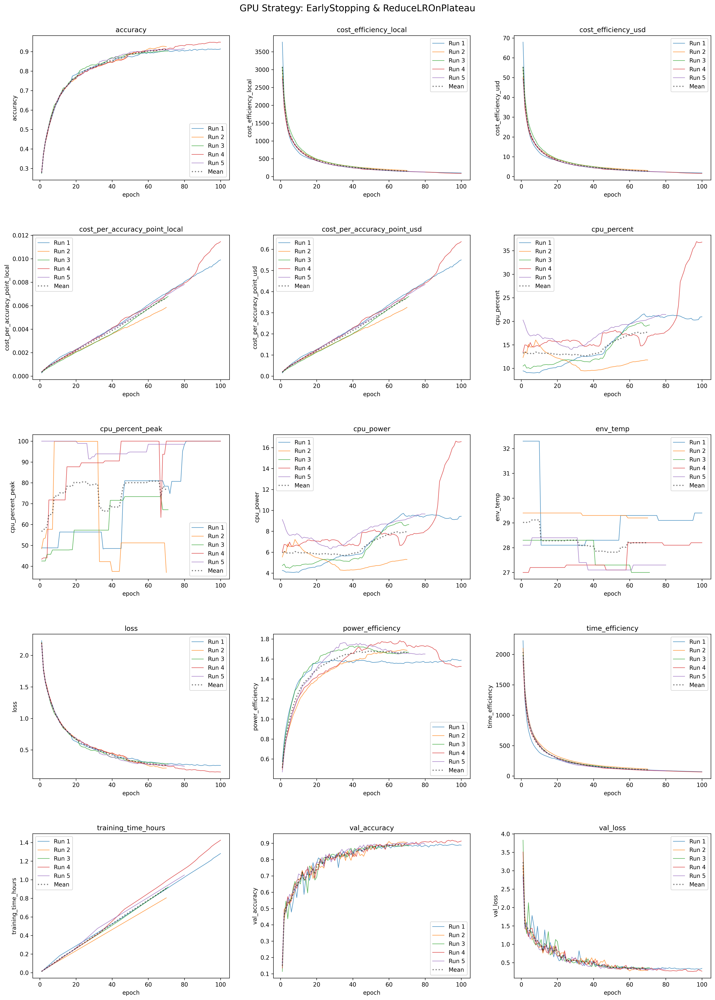

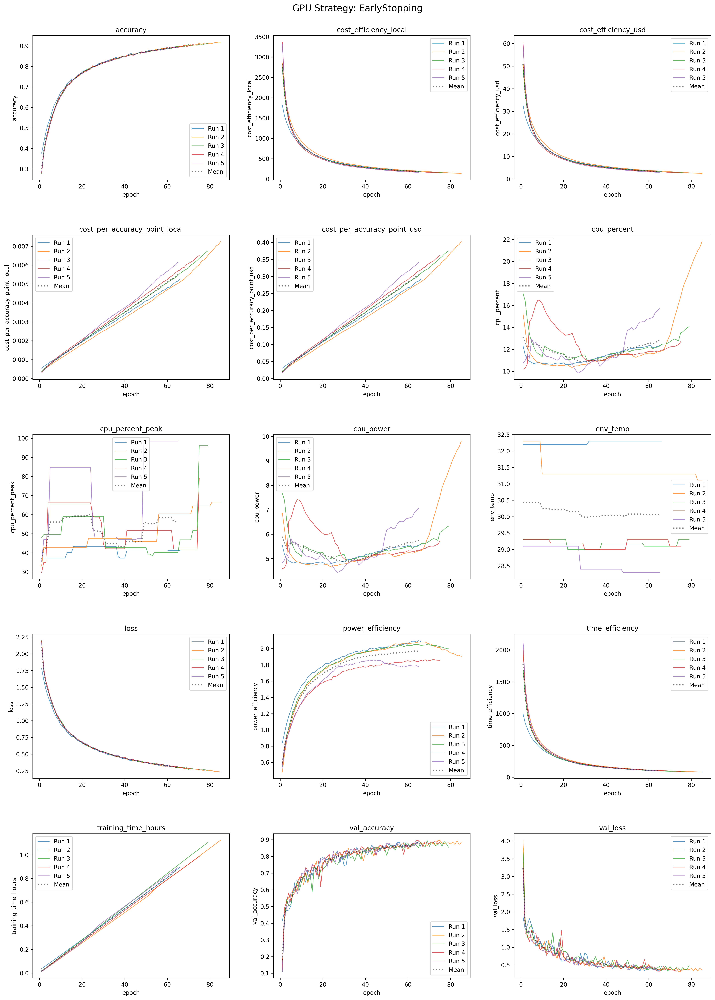

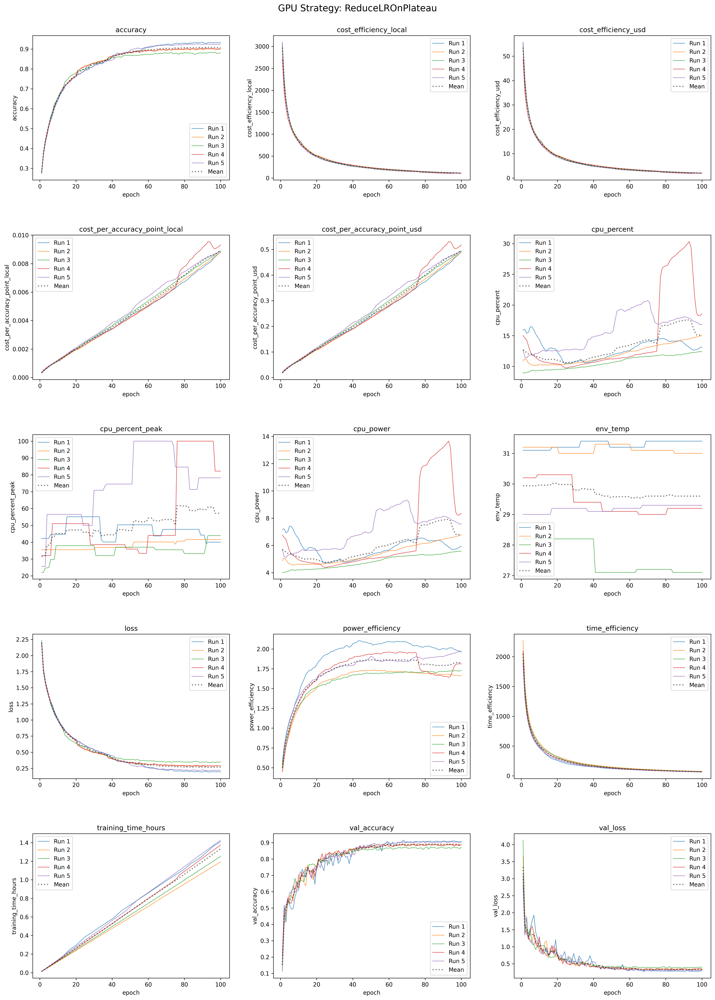

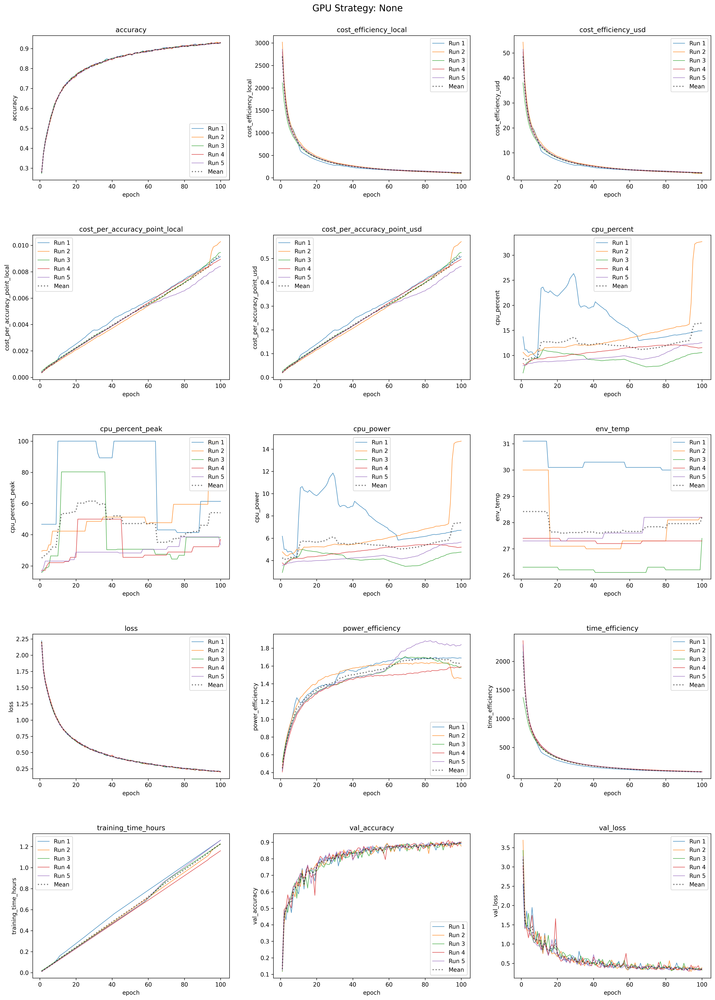

In [26]:
# GPU Plots
for strat in gpu_strats:
    total_runs = len(logs["gpu"][strat])
    evade_cols = [*not_to_plot, *related_cols['gpu']]
    target_cols = list(logs["gpu"][strat][0].columns.difference(evade_cols))
    fig, axes = create_subplots(*target_cols)

    if fig is None or axes is None:
        print(f"Skipping plotting for {strat} due to no valid columns.")
        continue

    fig.suptitle(
        f"GPU Strategy: {strat}",
        fontsize = 16,
    )

    colors = sns.color_palette(
        "tab10",
        n_colors = len(logs["gpu"][strat])
    )

    mean_df = pd.DataFrame(
        columns = logs["gpu"][strat][0].columns.difference(target_cols).tolist()
    )

    for col in logs["gpu"][strat][0].columns:
        if col not in evade_cols:
            continue
        mean_df[col] = logs["gpu"][strat][0][col]

    for i, ax in enumerate(axes):
        for run, run_df in enumerate(logs["gpu"][strat]):
            col = target_cols[i]
            x = run_df["epoch"]
            y = run_df[col]

            # Get the mean of the current column across all runs
            if col not in mean_df:
                mean_df[col] = y
            else:
                mean_df[col] = mean_df[col] + y

            ax.plot(
                x, y,
                label = f"Run {run + 1}",
                color = colors[run],
                linewidth = 1.0,
                linestyle = "-",
                alpha = 0.75,
            )
        
        ax.set_title(target_cols[i])
        ax.legend()
        ax.set_xlabel('epoch')
        ax.set_ylabel(target_cols[i])

    # Reconfigure the columns of mean_df to match the original DataFrame
    mean_df = mean_df[logs["gpu"][strat][0].columns.tolist()]

    # Calculate the mean across all runs for each column
    for i, ax in enumerate(axes):
        x = mean_df["epoch"]
        y = mean_df[target_cols[i]].apply(lambda x: x / total_runs)

        ax.plot(
            x, y,
            label = "Mean",
            color = "black",
            linewidth = 2.0,
            linestyle = ":",
            alpha = 0.5,
        )
        ax.legend()

    fig.tight_layout(
        pad = 3,
        h_pad = 5,
    )
    plt.show()

## Extraction

Extract key data from the gathered data (log data) to finalize the quantitative side of the paper.

Subsections:

- [Performance Metrics](#performance-metrics)
  - Final `val_accuracy`
  - Final `val_loss`
  - Final `accuracy`
  - Final `loss`
- [Total Training Time](#total-training-time)
  - `training_time_hours`
- [Resource Usage Metrics](#resource-usage-metrics)
  - Average
    - `cpu_percent`
    - `cpu_power`
    - `gpu_load`
    - `gpu_power`
    - `gpu_temp`
    - `env_temp`
  - Peak
    - `cpu_percent_peak`
    - `cpu_power_peak`
    - `gpu_load_peak`
    - `gpu_power_peak`
    - `gpu_temp_peak`
- [Efficiency Metric](#efficiency-metrics)
    - Average `cost_efficiency_local`
    - Average `cost_per_accuracy_point_local`
    - Average `cost_efficiency_usd`
    - Average `cost_per_accuracy_point_usd`
    - Average `power_efficiency`
    - Average `time_efficiency`


In [130]:
performance = {
    "gpu": {
    },
    "cpu": {
    },
}

tth = {
    "gpu": {
    },
    "cpu": {
    },
}

usage = {
    "gpu": {
    },
    "cpu": {
    },
}

efficiency = {
    "gpu": {
    },
    "cpu": {
    },
}

In [131]:
for platform, strategies in logs.items():
    for strat in strategies.keys():
        performance[platform][strat] = {}
        tth[platform][strat] = {}
        usage[platform][strat] = {}
        efficiency[platform][strat] = {}

performance

{'gpu': {'EarlyStopping & ReduceLROnPlateau': {},
  'EarlyStopping': {},
  'ReduceLROnPlateau': {},
  'None': {}},
 'cpu': {'EarlyStopping & ReduceLROnPlateau': {},
  'EarlyStopping': {},
  'ReduceLROnPlateau': {},
  'None': {}}}

### Performance Metrics

- Final `val_accuracy`
- Final `val_loss`
- Final `accuracy`
- Final `loss`

In [132]:
target_cols = [
    "val_accuracy",
    "val_loss",
    "accuracy",
    "loss",
]

for platform, strategies in logs.items():
    for strat, runs in strategies.items():
        for index, run in enumerate(runs):
            performance[platform][strat][f'Run {index + 1}'] = {}
            for col in target_cols:
                data = run.iloc[-1][col]
                performance[platform][strat][f'Run {index + 1}'][col] = data

print(performance["gpu"]["None"])
print("")
print(performance["cpu"]["None"])

{'Run 1': {'val_accuracy': 0.8902243375778198, 'val_loss': 0.36179065704345703, 'accuracy': 0.927649974822998, 'loss': 0.20748071372509003}, 'Run 2': {'val_accuracy': 0.8768028616905212, 'val_loss': 0.38683801889419556, 'accuracy': 0.9279000163078308, 'loss': 0.204970121383667}, 'Run 3': {'val_accuracy': 0.9020432829856873, 'val_loss': 0.3223481774330139, 'accuracy': 0.9287499785423279, 'loss': 0.20410482585430145}, 'Run 4': {'val_accuracy': 0.8992387652397156, 'val_loss': 0.3431873023509979, 'accuracy': 0.9309499859809875, 'loss': 0.20001836121082306}, 'Run 5': {'val_accuracy': 0.8926281929016113, 'val_loss': 0.36092573404312134, 'accuracy': 0.9289500117301941, 'loss': 0.20708207786083221}}

{'Run 1': {'val_accuracy': 0.8838140964508057, 'val_loss': 0.3880113661289215, 'accuracy': 0.9312999844551086, 'loss': 0.20261789858341217}}


### Total Training Time

- `training_time_hours`

In [133]:
for platform, strategies in logs.items():
    for strat, runs in strategies.items():
        for index, run in enumerate(runs):
            tth[platform][strat][f'Run {index + 1}'] = run['training_time_hours'].max()

print(tth["gpu"]["None"])
print("")
print(tth["cpu"]["None"])

{'Run 1': 1.2602696708838146, 'Run 2': 1.2251962125963636, 'Run 3': 1.2248439028528002, 'Run 4': 1.1601476835542255, 'Run 5': 1.2609055995941163}

{'Run 1': 26.48895659731494}


### Resource Usage Metrics

Gets the overall, average (mean), and peak values for resource usage for both CPU and GPU.

- Average/Peak `cpu_percent`
- Average/Peak `cpu_power`
- Average/Peak `gpu_load`
- Average/Peak `gpu_power`
- Average/Peak `gpu_temp`
- Average `env_temp`

In [134]:
target_cols = {
    "cpu_percent": "mean",
    "cpu_percent_peak": "max",
    "cpu_power": "mean",
    "cpu_power_peak": "max",
    "gpu_load": "mean",
    "gpu_load_peak": "max",
    "gpu_power": "mean",
    "gpu_power_peak": "max",
    "gpu_temp": "mean",
    "gpu_temp_peak": "max",
    "env_temp": "mean",
}

for platform, strategies in logs.items():
    for strat, runs in strategies.items():
        for index, run in enumerate(runs):
            usage[platform][strat][f'Run {index + 1}'] = {}
            for col, action in target_cols.items():
                if col not in run.columns:
                    sub_col = col.replace("_peak", "")
                    data = eval(f"run['{sub_col}'].{action}()")
                else:
                    data = eval(f"run['{col}'].{action}()")
                    
                usage[platform][strat][f'Run {index + 1}'][col] = data

print(usage["gpu"]["None"])
print("")
print(usage["cpu"]["None"])

{'Run 1': {'cpu_percent': 16.955800000000004, 'cpu_percent_peak': 100.0, 'cpu_power': 7.630110000000001, 'cpu_power_peak': 11.8485, 'gpu_load': 78.13140000000001, 'gpu_load_peak': 92.0, 'gpu_power': 47.55619999999999, 'gpu_power_peak': 72.32, 'gpu_temp': 85.62180000000004, 'gpu_temp_peak': 88.0, 'env_temp': 30.263000000000005}, 'Run 2': {'cpu_percent': 14.158500000000002, 'cpu_percent_peak': 100.0, 'cpu_power': 6.3713250000000015, 'cpu_power_peak': 14.715, 'gpu_load': 82.0232, 'gpu_load_peak': 91.0, 'gpu_power': 49.10360000000001, 'gpu_power_peak': 71.76, 'gpu_temp': 85.8812, 'gpu_temp_peak': 88.0, 'env_temp': 27.767}, 'Run 3': {'cpu_percent': 9.307099999999998, 'cpu_percent_peak': 80.3, 'cpu_power': 4.188195, 'cpu_power_peak': 4.999499999999999, 'gpu_load': 80.6751, 'gpu_load_peak': 94.0, 'gpu_power': 52.82480000000001, 'gpu_power_peak': 73.73, 'gpu_temp': 84.83239999999998, 'gpu_temp_peak': 88.0, 'env_temp': 26.212999999999994}, 'Run 4': {'cpu_percent': 10.829199999999998, 'cpu_perce

### Efficiency Metrics

Gets the overall and average (mean) values on how efficient the training was on both CPU and GPU.

- Average `cost_efficiency_local`
- Average `cost_per_accuracy_point_local`
- Average `cost_efficiency_usd`
- Average `cost_per_accuracy_point_usd`
- Average `power_efficiency`
- Average `time_efficiency`

In [135]:
target_cols = [
    "cost_efficiency_local",
    "cost_per_accuracy_point_local",
    
    "cost_efficiency_usd",
    "cost_per_accuracy_point_usd",
    
    "power_efficiency",
    "time_efficiency",
]

for platform, strategies in logs.items():
    for strat, runs in strategies.items():
        for index, run in enumerate(runs):
            efficiency[platform][strat][f'Run {index + 1}'] = {}
            for col in target_cols:
                data = run[col].mean()
                efficiency[platform][strat][f'Run {index + 1}'][col] = data

print(efficiency["gpu"]["None"])
print("")
print(efficiency["cpu"]["None"])

{'Run 1': {'cost_efficiency_local': 339.5857255742038, 'cost_per_accuracy_point_local': 0.005008966458567038, 'cost_efficiency_usd': 6.112543060335668, 'cost_per_accuracy_point_usd': 0.2782759143648355, 'power_efficiency': 1.5054119218363224, 'time_efficiency': 236.442106471546}, 'Run 2': {'cost_efficiency_local': 375.37613037135924, 'cost_per_accuracy_point_local': 0.004725002974507151, 'cost_efficiency_usd': 6.7567703466844655, 'cost_per_accuracy_point_usd': 0.2625001652503973, 'power_efficiency': 1.489414600385364, 'time_efficiency': 256.0670867028627}, 'Run 3': {'cost_efficiency_local': 337.1998162868283, 'cost_per_accuracy_point_local': 0.004805863510402128, 'cost_efficiency_usd': 6.069596693162907, 'cost_per_accuracy_point_usd': 0.26699241724456274, 'power_efficiency': 1.4544376546240034, 'time_efficiency': 238.7960353968015}, 'Run 4': {'cost_efficiency_local': 355.5942912918097, 'cost_per_accuracy_point_local': 0.00479525614328128, 'cost_efficiency_usd': 6.400697243252572, 'cost

## Summary Tables

